## Quick analysis of ELG truth table, and the failure modes

In [1]:
import os, sys, glob
import numpy as np

from astropy.io import fits
from astropy.table import Table, join, vstack
from astropy.io import fits

import pandas as pd
import fnmatch

import desispec.io

#import desispec
# library location will change ..
sys.path.append("/global/homes/r/rtojeiro/prospect/prospect/py")
from prospect import utils_specviewer,plotframes
import matplotlib.pyplot as plt 
fs = 15

In [2]:
tiledir   = '/global/cfs/cdirs/desi/spectro/redux/daily/tiles/'
tiles = ['67230']
nights = ['20200315']
petals = ['0','1', '2', '3', '4', '5', '6' ,'7', '8', '9']
obs_db = utils_specviewer.make_targetdict(tiledir, petals=petals, tiles=tiles) # tiles = optional 
del obs_db['67230-20200314']
obs_db.keys()

dict_keys(['67230-20200315'])

In [3]:
pd.set_option('display.max_rows', 20)

In [4]:
def display_spectra(targetIDs, show_spectra=None):

    # VI interface in notebook
    if show_spectra:
        spectra, zcat= utils_specviewer.load_spectra_zcat_from_targets(targetIDs, tiledir, obs_db)
        plotframes.plotspectra(spectra, zcatalog=zcat, title='Target_select', notebook=True, mask_type='CMX_TARGET',with_vi_widgets=False)

### Read table

In [5]:
VI_dir = os.environ['HOME']+'/SV/VI_files/SV0/ELG/'

filenames = ['truth_table_ELGs_sets11_15.txt' , 'truth_table_ELGs_sets5_10.txt', 'truth_table_ELGs_sets16_20.txt']
#'truth_table_ELGs_sets2_4.txt',
merged_full = pd.read_csv(VI_dir+filenames[0])
for i in range(1,len(filenames)):
    merged = pd.read_csv(VI_dir+filenames[i])
    merged_full = merged_full.append(merged, ignore_index=True,sort=False)

full_filename='truth_table_ELG_partial_67230.txt'
merged_full.to_csv(VI_dir + full_filename)

In [6]:
tt = pd.read_csv(VI_dir+full_filename)
tt['dz'] = (tt['Redrock z'] - tt['best redshift'])/(1 + tt['best redshift'])

In [7]:
tt.keys()

Index(['Unnamed: 0', 'TargetID', 'Redrock z', 'Redrock spectype',
       'best redshift', 'best spectype', 'vi_combined_flag', 'N_VI',
       'all VI comments', 'merger comment', 'DELTACHI2', 'FIBER', 'FLUX_G',
       'FLUX_R', 'FLUX_Z', 'FIBERFLUX_G', 'FIBERFLUX_R', 'FIBERFLUX_Z', 'dz'],
      dtype='object')

In [8]:
len(tt)

800

## Histogram of combined flags
A combined flag is the mean of the flags of all inspectors in the cases where there are no conflicts, or a flag manually set by a merger in case of conflicts.

**We take all objects with a combined flag greater than 2.5 as secure.**

Text(0,0.5,'N')

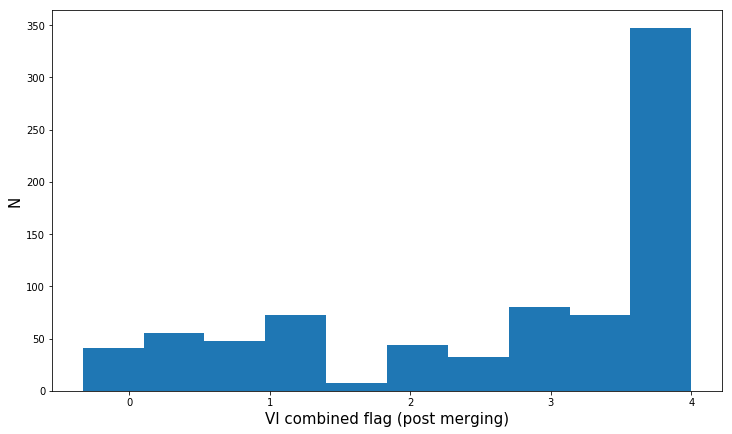

In [9]:
plt.figure(figsize=(12,7))
plt.hist(tt['vi_combined_flag'])
plt.xlabel('VI combined flag (post merging)', fontsize=fs)
plt.ylabel('N', fontsize=fs)

## Redshift distribution

In [10]:
good_z = tt[(tt['vi_combined_flag'] >=2.5)]
elgs = tt[(tt['best redshift'] > 0.6) & (tt['best redshift'] < 1.6) & (tt['best spectype'] == 'GALAXY')]
good = tt[(tt['vi_combined_flag'] >=2.5) & (tt['best redshift'] > 0.6) & (tt['best redshift'] < 1.6) & (tt['best spectype'] == 'GALAXY')]
print(len(elgs))
print(len(good))
print(len(good_z))

636
477
521


In [11]:
print('fraction of secure ELG redshifts: ',len(good)/len(elgs))

fraction of secure ELG redshifts:  0.75


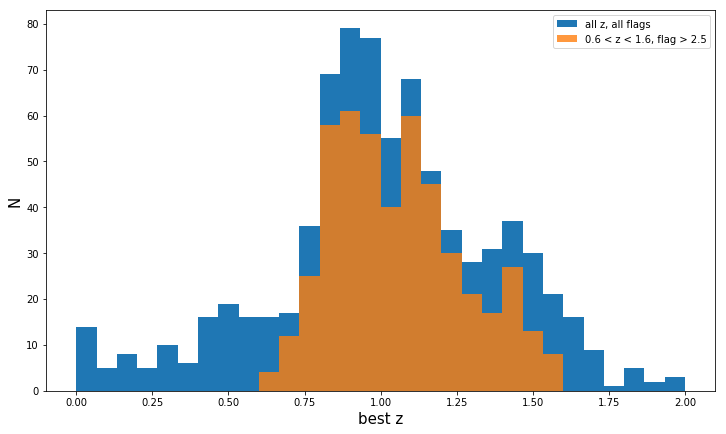

In [12]:
plt.figure(figsize=(12,7))
plt.hist(tt['best redshift'], label='all z, all flags', range=(0,2), bins=30)
plt.hist(good['best redshift'], label = '0.6 < z < 1.6, flag > 2.5', range=(0,2), bins=30, alpha=0.8)
plt.xlabel('best z', fontsize=fs)
plt.ylabel('N', fontsize=fs)
plt.legend()

## Looking at the failures in more detail

We define **secure failures** as objects for which redrock got the wrong redshift, but VI provides a secure redshift.

We define **not secure failures** as objects for which redrock (probably) got the wrong redshift, and for which inspectors attempted an alternative redshift, but with low confidence.

We can then inspect each of these sets in a dedicated prospect window.

(below, we will also look at all spectra with poor VI flags)

Text(0,0.5,'Redrock z')

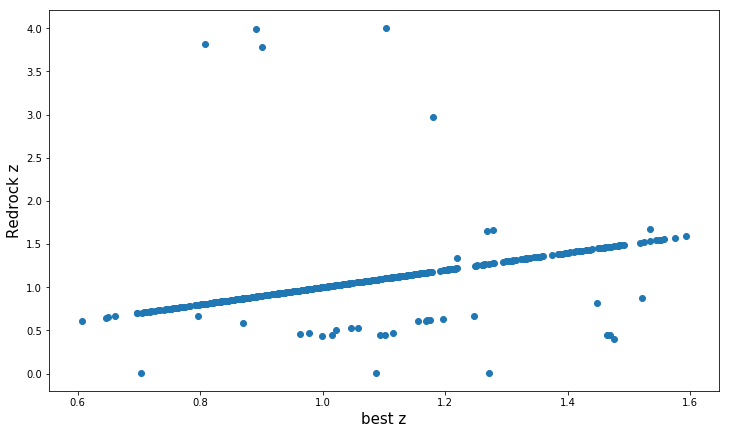

In [13]:
plt.figure(figsize=(12,7))
plt.scatter(good['best redshift'],good['Redrock z'] )
plt.xlabel('best z', fontsize=fs)
plt.ylabel('Redrock z', fontsize=fs)

In [14]:
fail_secure = tt[(np.abs(tt['dz'])>0.0033) & (tt['vi_combined_flag']>=2.5)]
print(len(fail_secure))

38


In [15]:
display(fail_secure[fail_secure.TargetID == 35185741948523207])
print(fail_secure[fail_secure.TargetID == 35185741948523207]['merger comment'].to_list())

,Unnamed: 0,TargetID,Redrock z,Redrock spectype,best redshift,best spectype,vi_combined_flag,N_VI,all VI comments,merger comment,DELTACHI2,FIBER,FLUX_G,FLUX_R,FLUX_Z,FIBERFLUX_G,FIBERFLUX_R,FIBERFLUX_Z,dz


[]


In [16]:
display_spectra(fail_secure['TargetID'].to_list(), show_spectra=True)

Loading BokehJS ...

In [17]:
fail_not_secure = tt[(np.abs(tt['dz'])>0.0033) & (tt['vi_combined_flag']<2.5)]
print(len(fail_not_secure))

34


In [18]:
#display_spectra(fail_not_secure['TargetID'].to_list(), show_spectra=True)

## Looking at poor-quality spectra

More generally, we can look at ALL spectra with poor quality flags (for many of these, the redrock z will have been left untouched, and do not qualify as "failures")

In [19]:
not_secure = tt[tt['vi_combined_flag']<2.5]
print(len(not_secure))

279


In [20]:
#too many to load - subsample these
rnd_index = np.fix(np.random.random(50)*(len(not_secure)+1))
display_spectra(not_secure.iloc[rnd_index]['TargetID'].to_list(), show_spectra=True)

Loading BokehJS ...

## Looking at spectra with certain keywords in the merger comment field

In [21]:
broad_OII = tt[tt['merger comment'].str.contains('broad') ]

In [22]:
broad_OII

,Unnamed: 0,TargetID,Redrock z,Redrock spectype,best redshift,best spectype,vi_combined_flag,N_VI,all VI comments,merger comment,DELTACHI2,FIBER,FLUX_G,FLUX_R,FLUX_Z,FIBERFLUX_G,FIBERFLUX_R,FIBERFLUX_Z,dz
25,25,35185754032309750,1.2374,QSO,1.23740,QSO,2.000000,3,MgII emission; Hbeta absorption/emission?| QS...,"broad emission line, but odd continuum. disagr...",48.094389,813,0.367138,0.861786,2.617534,0.285670,0.670556,2.036705,0.000000
188,188,35185754057478722,1.4611,GALAXY,1.46110,GALAXY,2.666667,3,--|--| Triple peak [OII] emission,flag disagreement due to broadened but not res...,189.383709,4930,0.281289,0.344581,0.709415,0.200448,0.245550,0.505532,0.000000
209,209,35185760059523574,0.6155,GALAXY,1.17005,GALAXY,3.000000,3,Possible broad [OII] emission at z~1.1698; ca...,2/3 inspectors suggest same VI z. take mean. O...,50.077787,1379,0.246229,0.330678,0.728312,0.191841,0.257637,0.567440,-0.255547
224,224,35185760063720985,0.6047,GALAXY,1.15550,GALAXY,3.000000,3,Broad [OII] emission at z~1.1554; Calibration ...,VI z based on strong OII. broadned not resolved.,65.893808,1349,0.340089,0.394402,0.919703,0.216862,0.251495,0.586460,-0.255532
319,319,35185747988316811,0.6141,GALAXY,0.61410,QSO,4.000000,3,ELG or BGS ?| Broad MgII and strong OIII| [OI...,disagreement in spectype. broad MgII so set to...,2731.733192,898,1.525291,2.508843,7.614735,1.021561,1.680293,5.099955,0.000000
389,389,35185747996708490,1.4081,GALAXY,1.40810,QSO,4.000000,3,[OII]| Very broad CIII] absorption?|--,disagreement in spectype due to possible broad...,89.153585,598,0.237655,0.187328,0.486850,0.185086,0.145891,0.379159,0.000000
563,563,35185760072111453,1.3034,GALAXY,1.30340,GALAXY,3.000000,3,--|--| Triple peak [OII],flag disagreement. strong OII broadened but no...,101.047926,712,0.383718,0.478351,1.286498,0.186489,0.232481,0.625243,0.000000
618,618,35185760084690463,1.1655,GALAXY,1.16550,GALAXY,3.000000,3,Broad [OII]| possible OII|--,disagreement in flag but z is secure - broad O...,194.289187,142,0.488259,0.591792,1.336711,0.302688,0.366872,0.828672,0.000000
657,657,35185760093081557,0.9444,GALAXY,0.94440,QSO,4.000000,3,AGN with broad MgII emission which is not cap...,disagreement in flag but z is secure. broad Mg...,311.324931,4797,4.225689,4.965032,6.732031,3.290851,3.866631,5.242721,0.000000
722,722,35185760101471222,1.0710,GALAXY,1.07100,QSO,4.000000,4,noisy spectra|unsecure doublet (weak and at t...,disagreement in flag and spectype. z is secure...,250.577914,4026,1.061869,1.850926,5.079148,0.753330,1.313117,3.603342,0.000000


In [23]:
display_spectra(broad_OII['TargetID'].to_list(), show_spectra=True)

Loading BokehJS ...

In [24]:
sky_OII = tt[tt['merger comment'].str.contains('sky') ]

In [25]:
sky_OII

,Unnamed: 0,TargetID,Redrock z,Redrock spectype,best redshift,best spectype,vi_combined_flag,N_VI,all VI comments,merger comment,DELTACHI2,FIBER,FLUX_G,FLUX_R,FLUX_Z,FIBERFLUX_G,FIBERFLUX_R,FIBERFLUX_Z,dz
30,30,35185754032310703,1.5176,GALAXY,1.5176,GALAXY,2.666667,3,--|--|--,mismatch in flag. OII is there and just misses...,101.810069,798,0.337239,0.435529,0.727244,0.216438,0.279520,0.466740,0.000000
46,46,35185754036503154,1.4978,GALAXY,1.4978,GALAXY,2.333333,3,[OII] in sky lines|--|--,"disagreement in flag. OII doublet on skylines,...",49.732391,144,0.210063,0.209993,0.119563,0.163284,0.163230,0.092938,0.000000
52,52,35185754036503964,1.5405,GALAXY,1.5405,GALAXY,2.000000,3,--| Possible triple peak [OII] between sky lin...,flag disagreement due to possible doublet in s...,42.366031,963,0.268587,0.275152,0.217786,0.208454,0.213550,0.169028,0.000000
93,93,35185754040700578,0.8774,GALAXY,1.5220,GALAXY,2.500000,3,--| Possible [OII] at z~1.522 next to sky line...,disagreement in z and flag. redrock z is wrong...,31.236683,100,0.308028,0.358506,0.568971,0.193887,0.225661,0.358138,-0.255591
161,161,35185754053284109,1.1543,GALAXY,1.1543,GALAXY,3.000000,3,--|--|--,disagreement in flag. doublet partially on sky...,85.516308,4959,0.400827,0.346481,0.684189,0.172152,0.148811,0.293854,0.000000
191,191,35185754061670674,1.4008,GALAXY,1.4008,GALAXY,3.000000,3,--|--|--,"doublet partially on sky line, still secure. s...",283.147376,4801,0.451099,0.459233,1.072490,0.293532,0.298824,0.697873,0.000000
245,245,35185760072106551,1.1398,GALAXY,1.1398,GALAXY,3.000000,3,[OII] emission on sky lines|--|--,disagreement in flag. OII on top of skyline bu...,24.186601,786,0.276603,0.248809,0.105162,0.088323,0.079448,0.033580,0.000000
565,565,35185760076300581,1.5667,GALAXY,1.5667,GALAXY,2.000000,3,--|unsecure doublet in noisy region + no signa...,"flag disagreement, possible weak doublet on sk...",11.692591,603,0.312639,0.298164,0.425128,0.209338,0.199646,0.284658,0.000000
732,732,35185760105662202,0.7661,GALAXY,1.3715,GALAXY,2.000000,4,Very noisy data OIII line is resolved at λobs~...,"very low SNR. 2/4 inspectors suggest VI z, bas...",15.134168,4390,0.365650,0.589905,1.560254,0.146514,0.236372,0.625185,-0.255281
760,760,35185766099323497,0.4462,GALAXY,1.4644,GALAXY,3.000000,3,Bad calibration feature 5800 A| Poor continuu...,disagreement in flag and z. 2 VI redshifts bas...,124.667180,1478,0.216651,0.172806,0.320011,0.168742,0.134593,0.249246,-0.413163


In [26]:
display_spectra(sky_OII['TargetID'].to_list(), show_spectra=True)

Loading BokehJS ...

## Looking at delta_chi2

Text(0,0.5,'normalised distribution')

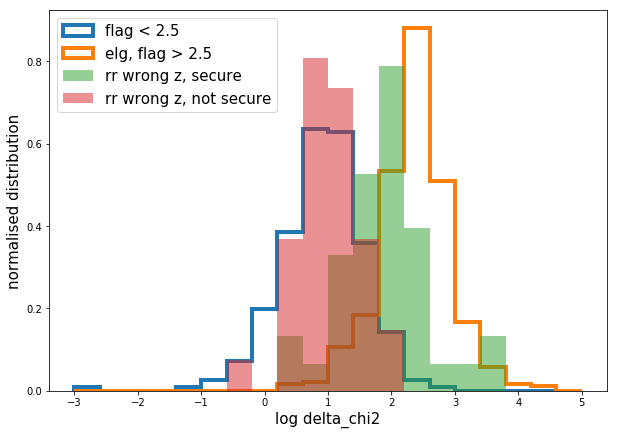

In [28]:
range=(-3,5)
plt.figure(figsize=(10,7))
plt.hist(np.log10(not_secure['DELTACHI2']), label='flag < 2.5', histtype='step', normed=True, range=range, bins=20, lw=4)
plt.hist(np.log10(good['DELTACHI2']), label='elg, flag > 2.5', histtype='step', normed=True, range=range, bins=20, lw=4)
plt.hist(np.log10(fail_secure['DELTACHI2']), label='rr wrong z, secure', normed=True, alpha=0.5, range=range, bins=20, lw=4)
plt.hist(np.log10(fail_not_secure['DELTACHI2']), label='rr wrong z, not secure', alpha=0.5, normed=True, range=range, bins=20, lw=4)
plt.legend(fontsize=fs)
plt.xlabel('log delta_chi2', fontsize=fs)
plt.ylabel('normalised distribution', fontsize=fs)